In [1]:
import numpy as np
import pandas as pd

from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import plotly.express as px
import seaborn as sns

## Import data

In [2]:
def get_data(cell: str, tech: str, l_or_d: str):
    path = f"../{l_or_d}/data/HS65_GH_{cell}_{tech}.csv"
    dataset = pd.read_csv(path)
    dataset.drop(dataset.columns[0], axis=1, inplace=True)
    return dataset

In [3]:
NOT_16HP_l = get_data("NOT", "16nm_HP", "leakage")
NOT_22HP_l = get_data("NOT", "22nm_HP", "leakage")
NOT_32HP_l = get_data("NOT", "32nm_HP", "leakage")
NOT_45HP_l = get_data("NOT", "45nm_HP", "leakage")
NOT_22MGK_l = get_data("NOT", "22nm_MGK", "leakage")
NOT_32MGK_l = get_data("NOT", "32nm_MGK", "leakage")
NOT_45MGK_l = get_data("NOT", "45nm_MGK", "leakage")

In [4]:
NOT_16HP_d = get_data("NOT", "16nm_HP", "delay")
NOT_22HP_d = get_data("NOT", "22nm_HP", "delay")
NOT_32HP_d = get_data("NOT", "32nm_HP", "delay")
NOT_45HP_d = get_data("NOT", "45nm_HP", "delay")
NOT_22MGK_d = get_data("NOT", "22nm_MGK", "delay")
NOT_32MGK_d = get_data("NOT", "32nm_MGK", "delay")
NOT_45MGK_d = get_data("NOT", "45nm_MGK", "delay")

## Scale data

In [5]:
def scale_data(dataset, num_y):
    x_data = dataset.iloc[:, :-num_y].to_numpy()
    y_data = dataset.iloc[:, -num_y:].to_numpy()

    scaler = StandardScaler()
    x_data = scaler.fit_transform(x_data)
    
    y_data = np.mean(y_data, axis=1)

    return x_data, y_data

In [6]:
x_NOT_16HP_l, y_NOT_16HP_l = scale_data(NOT_16HP_l, 1)
x_NOT_22HP_l, y_NOT_22HP_l = scale_data(NOT_22HP_l, 1)
x_NOT_32HP_l, y_NOT_32HP_l = scale_data(NOT_32HP_l, 1)
x_NOT_45HP_l, y_NOT_45HP_l = scale_data(NOT_45HP_l, 1)
x_NOT_22MGK_l, y_NOT_22MGK_l = scale_data(NOT_22MGK_l, 1)
x_NOT_32MGK_l, y_NOT_32MGK_l = scale_data(NOT_32MGK_l, 1)
x_NOT_45MGK_l, y_NOT_45MGK_l = scale_data(NOT_45MGK_l, 1)

In [7]:
x_NOT_16HP_d, y_NOT_16HP_d = scale_data(NOT_16HP_d, 2)
x_NOT_22HP_d, y_NOT_22HP_d = scale_data(NOT_22HP_d, 2)
x_NOT_32HP_d, y_NOT_32HP_d = scale_data(NOT_32HP_d, 2)
x_NOT_45HP_d, y_NOT_45HP_d = scale_data(NOT_45HP_d, 2)
x_NOT_22MGK_d, y_NOT_22MGK_d = scale_data(NOT_22MGK_d, 2)
x_NOT_32MGK_d, y_NOT_32MGK_d = scale_data(NOT_32MGK_d, 2)
x_NOT_45MGK_d, y_NOT_45MGK_d = scale_data(NOT_45MGK_d, 2)

In [8]:
techs = ["16nm_HP", "22nm_HP", "32nm_HP", "45nm_HP", "22nm_MGK", "32nm_MGK", "45nm_MGK"]

x_NOT_l = [x_NOT_16HP_l, x_NOT_22HP_l, x_NOT_32HP_l, x_NOT_45HP_l, x_NOT_22MGK_l, x_NOT_32MGK_l, x_NOT_45MGK_l]
y_NOT_l = [y_NOT_16HP_l, y_NOT_22HP_l, y_NOT_32HP_l, y_NOT_45HP_l, y_NOT_22MGK_l, y_NOT_32MGK_l, y_NOT_45MGK_l]

x_NOT_d = [x_NOT_16HP_d, x_NOT_22HP_d, x_NOT_32HP_d, x_NOT_45HP_d, x_NOT_22MGK_d, x_NOT_32MGK_d, x_NOT_45MGK_d]
y_NOT_d = [y_NOT_16HP_d, y_NOT_22HP_d, y_NOT_32HP_d, y_NOT_45HP_d, y_NOT_22MGK_d, y_NOT_32MGK_d, y_NOT_45MGK_d]

## Correlation maps

In [9]:
def correlation_map(x_data, y_data):
    combined_data = np.concatenate((x_data, y_data.reshape(-1, 1)), axis=1)
    corr_mat = np.corrcoef(combined_data, rowvar=False)

    return corr_mat

Text(0.5, 1.0, 'Correlation map for leakage in NOT 16nm_HP')

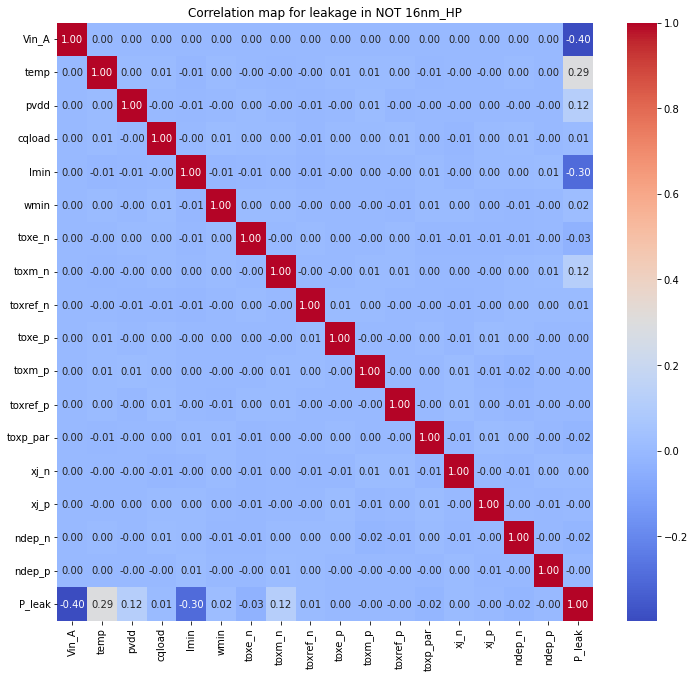

In [10]:
corrmat_NOT_16HP_l = correlation_map(x_NOT_16HP_l, y_NOT_16HP_l)
data_cols = NOT_16HP_l.columns

plt.figure(figsize=(12, 11))
sns.heatmap(corrmat_NOT_16HP_l, annot=True, fmt=".2f", xticklabels=data_cols, yticklabels=data_cols, cmap='coolwarm')
plt.title("Correlation map for leakage in NOT 16nm_HP")

Text(0.5, 1.0, 'Correlation map for leakage in NOT 45nm_HP')

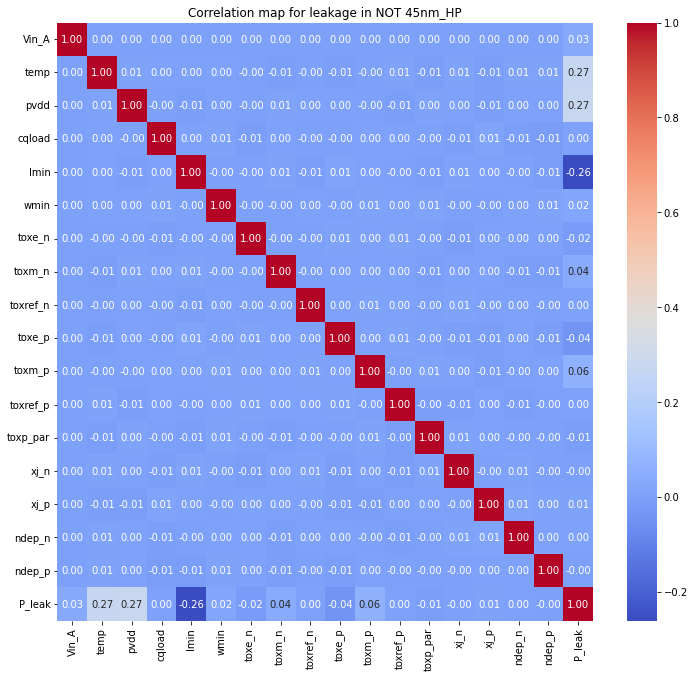

In [11]:
corrmat_NOT_45HP_l = correlation_map(x_NOT_45HP_l, y_NOT_45HP_l)
data_cols = NOT_45HP_l.columns

plt.figure(figsize=(12, 11))
sns.heatmap(corrmat_NOT_45HP_l, annot=True, fmt=".2f", xticklabels=data_cols, yticklabels=data_cols, cmap='coolwarm')
plt.title("Correlation map for leakage in NOT 45nm_HP")

Text(0.5, 1.0, 'Correlation map for leakage in NOT 45nm_MGK')

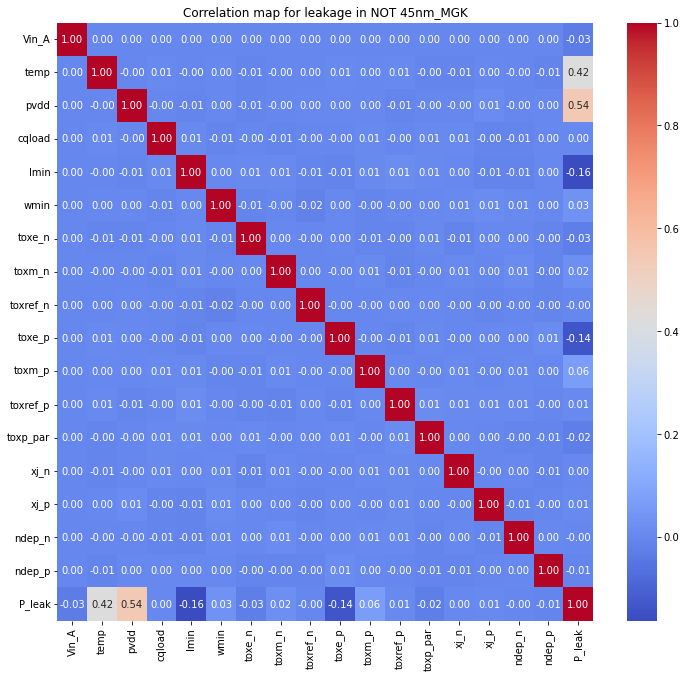

In [12]:
corrmat_NOT_45MGK_l = correlation_map(x_NOT_45MGK_l, y_NOT_45MGK_l)
data_cols = NOT_45MGK_l.columns

plt.figure(figsize=(12, 11))
sns.heatmap(corrmat_NOT_45MGK_l, annot=True, fmt=".2f", xticklabels=data_cols, yticklabels=data_cols, cmap='coolwarm')
plt.title("Correlation map for leakage in NOT 45nm_MGK")

Text(0.5, 1.0, 'Correlation map for delay in NOT 16nm_HP')

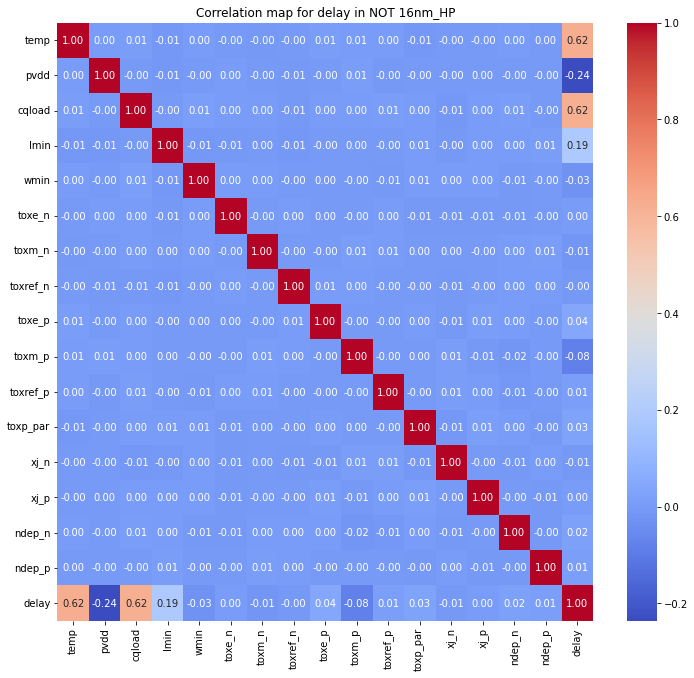

In [13]:
corrmat_NOT_16HP_d = correlation_map(x_NOT_16HP_d, y_NOT_16HP_d)
data_cols = NOT_16HP_d.columns[:-2]
data_cols = np.concatenate((data_cols, ["delay"]))

plt.figure(figsize=(12, 11))
sns.heatmap(corrmat_NOT_16HP_d, annot=True, fmt=".2f", xticklabels=data_cols, yticklabels=data_cols, cmap='coolwarm')
plt.title("Correlation map for delay in NOT 16nm_HP")

Text(0.5, 1.0, 'Correlation map for delay in NOT 45nm_HP')

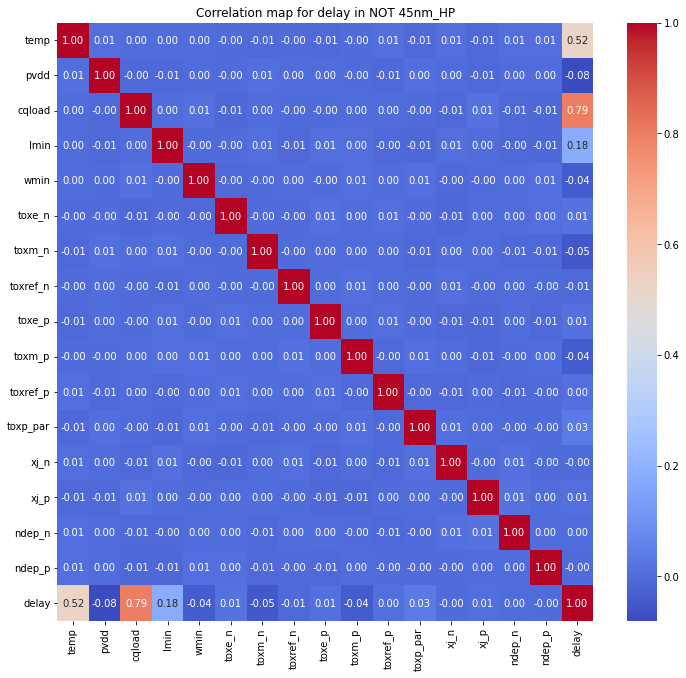

In [14]:
corrmat_NOT_45HP_d = correlation_map(x_NOT_45HP_d, y_NOT_45HP_d)
data_cols = NOT_16HP_d.columns[:-2]
data_cols = np.concatenate((data_cols, ["delay"]))

plt.figure(figsize=(12, 11))
sns.heatmap(corrmat_NOT_45HP_d, annot=True, fmt=".2f", xticklabels=data_cols, yticklabels=data_cols, cmap='coolwarm')
plt.title("Correlation map for delay in NOT 45nm_HP")

Text(0.5, 1.0, 'Correlation map for delay in NOT 45nm_MGK')

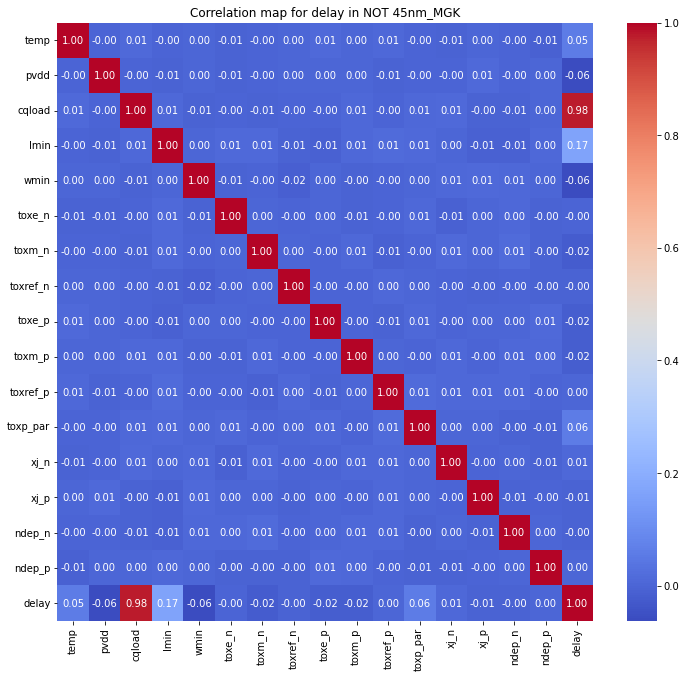

In [15]:
corrmat_NOT_45MGK_d = correlation_map(x_NOT_45MGK_d, y_NOT_45MGK_d)
data_cols = NOT_16HP_d.columns[:-2]
data_cols = np.concatenate((data_cols, ["delay"]))

plt.figure(figsize=(12, 11))
sns.heatmap(corrmat_NOT_45MGK_d, annot=True, fmt=".2f", xticklabels=data_cols, yticklabels=data_cols, cmap='coolwarm')
plt.title("Correlation map for delay in NOT 45nm_MGK")

## Scatter plots for leakage

In [16]:
NOT_l_columns = NOT_16HP_l.columns

Text(0.5, 0.98, 'Scatter plots for leakage in NOT cell (input 0) with 16nm_HP tech')

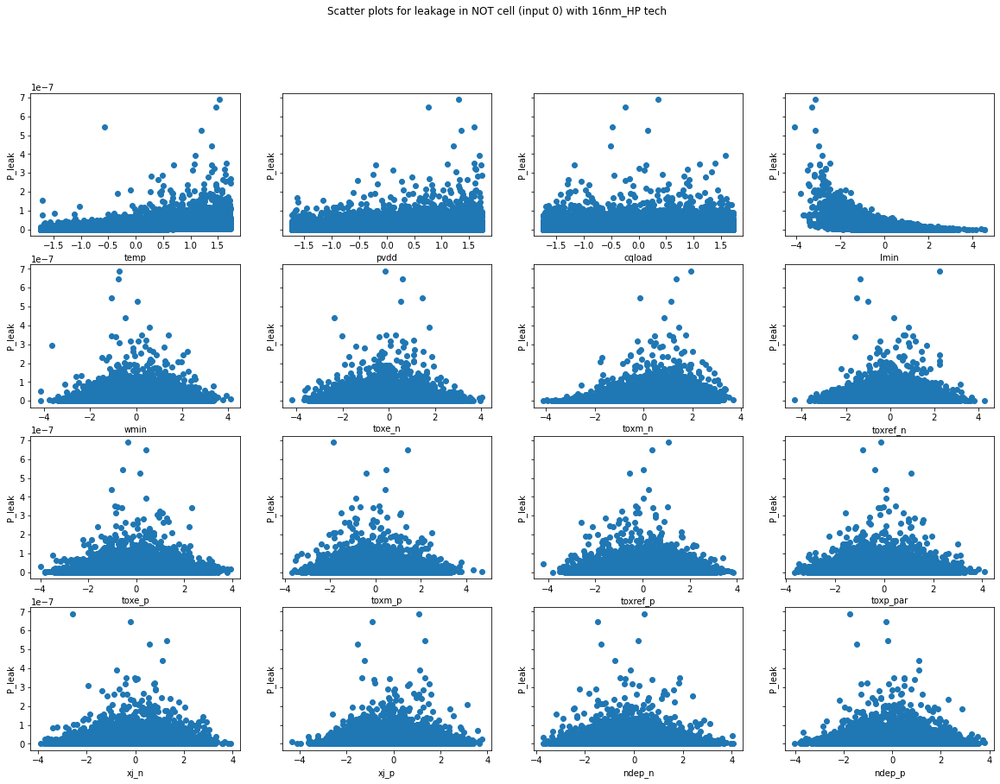

In [17]:
fig, ax = plt.subplots(4, 4, figsize=(20, 14), sharey=True)

for i in range(4):
    for j in range(4):
        k = 4*i + j + 1
        ax[i,j].scatter(x=x_NOT_16HP_l[::2, k], y=y_NOT_16HP_l[::2])
        ax[i,j].set_xlabel(NOT_l_columns[k])
        ax[i,j].set_ylabel(NOT_l_columns[-1])
fig.suptitle("Scatter plots for leakage in NOT cell (input 0) with 16nm_HP tech")

Text(0.5, 0.98, 'Scatter plots for leakage in NOT cell (input 1) with 16nm_HP tech')

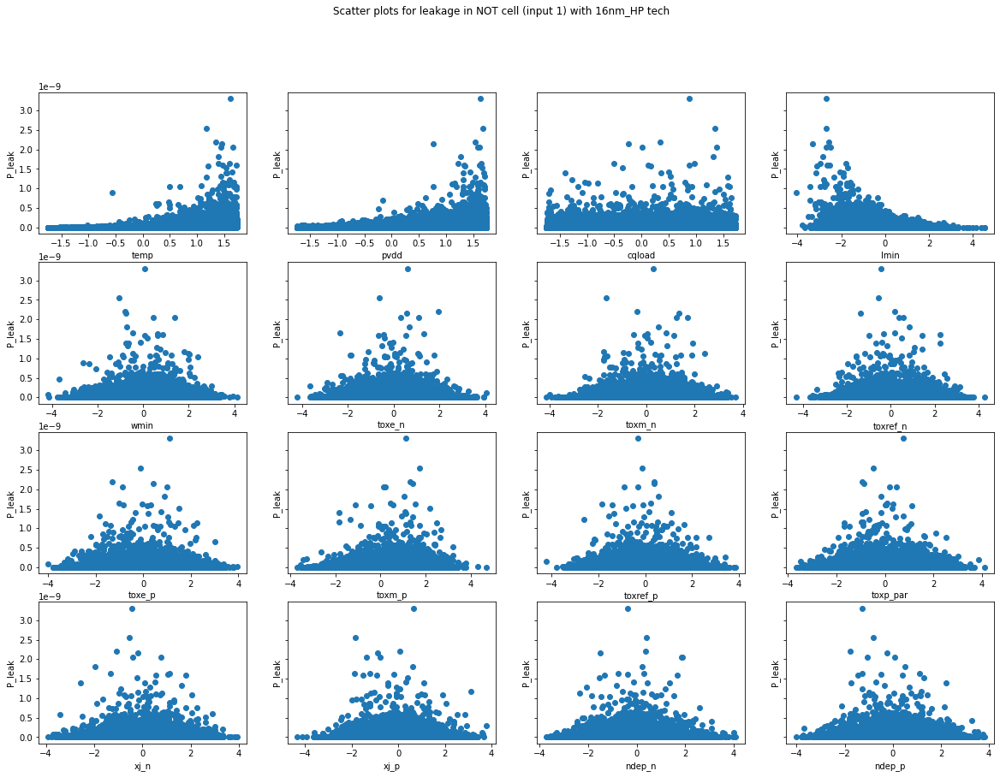

In [18]:
fig, ax = plt.subplots(4, 4, figsize=(20, 14), sharey=True)

for i in range(4):
    for j in range(4):
        k = 4*i + j + 1
        ax[i,j].scatter(x=x_NOT_16HP_l[1::2, k], y=y_NOT_16HP_l[1::2])
        ax[i,j].set_xlabel(NOT_l_columns[k])
        ax[i,j].set_ylabel(NOT_l_columns[-1])
fig.suptitle("Scatter plots for leakage in NOT cell (input 1) with 16nm_HP tech")

Text(0.5, 0.98, 'Checking effect of temperature on leakage for NOT cell (input 0)')

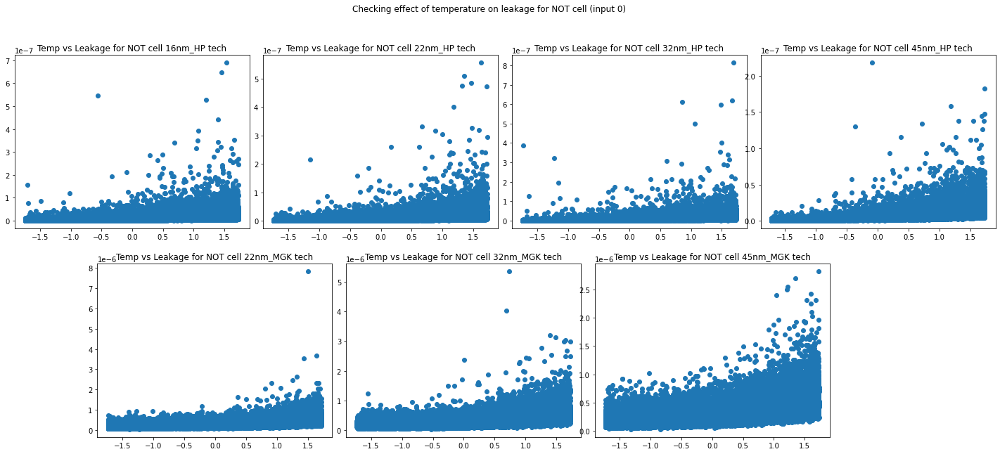

In [19]:
fig = plt.figure(figsize=(25, 10))
gs = gridspec.GridSpec(2, 12)

col = np.where(NOT_l_columns == "temp")

for i in range(7):
    if i < 4:
        ax = plt.subplot(gs[0, 3*i : 3*i+3])
    else:
        ax = plt.subplot(gs[1, 3*i-11 : 3*i+3-11])
    
    x_data = x_NOT_l[i]
    y_data = y_NOT_l[i]
    ax.scatter(x=x_data[::2, col], y=y_data[::2])
    ax.set_title(f"Temp vs Leakage for NOT cell {techs[i]} tech")

fig.suptitle("Checking effect of temperature on leakage for NOT cell (input 0)")

Text(0.5, 0.98, 'Checking effect of temperature on leakage for NOT cell (input 1)')

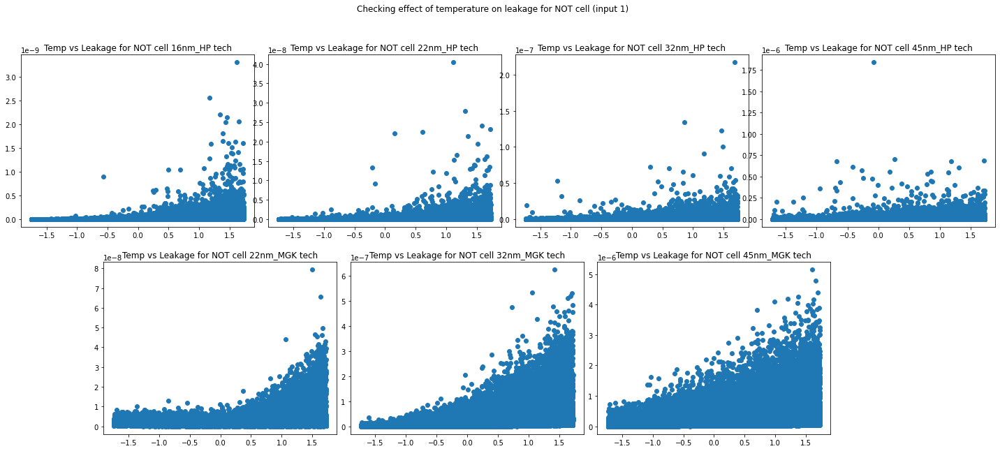

In [20]:
fig = plt.figure(figsize=(25, 10))
gs = gridspec.GridSpec(2, 12)

col = np.where(NOT_l_columns == "temp")

for i in range(7):
    if i < 4:
        ax = plt.subplot(gs[0, 3*i : 3*i+3])
    else:
        ax = plt.subplot(gs[1, 3*i-11 : 3*i+3-11])
    
    ax.scatter(x=x_NOT_l[i][1::2, col], y=y_NOT_l[i][1::2])
    ax.set_title(f"Temp vs Leakage for NOT cell {techs[i]} tech")

fig.suptitle("Checking effect of temperature on leakage for NOT cell (input 1)")

Text(0.5, 0.98, 'Checking effect of supply voltage on leakage for NOT cell (input 0)')

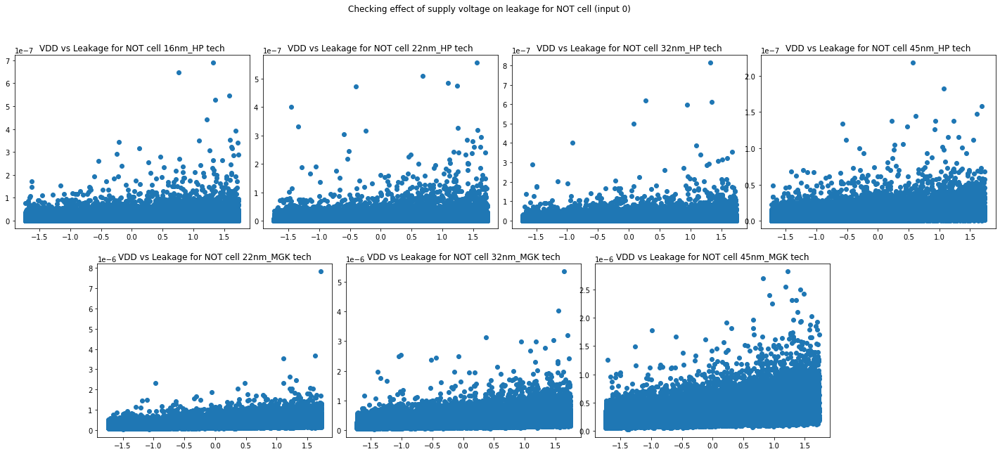

In [21]:
fig = plt.figure(figsize=(25, 10))
gs = gridspec.GridSpec(2, 12)

col = np.where(NOT_l_columns == "pvdd")

for i in range(7):
    if i < 4:
        ax = plt.subplot(gs[0, 3*i : 3*i+3])
    else:
        ax = plt.subplot(gs[1, 3*i-11 : 3*i+3-11])
    
    ax.scatter(x=x_NOT_l[i][::2, col], y=y_NOT_l[i][::2])
    ax.set_title(f"VDD vs Leakage for NOT cell {techs[i]} tech")

fig.suptitle("Checking effect of supply voltage on leakage for NOT cell (input 0)")

Text(0.5, 0.98, 'Checking effect of supply voltage on leakage for NOT cell (input 1)')

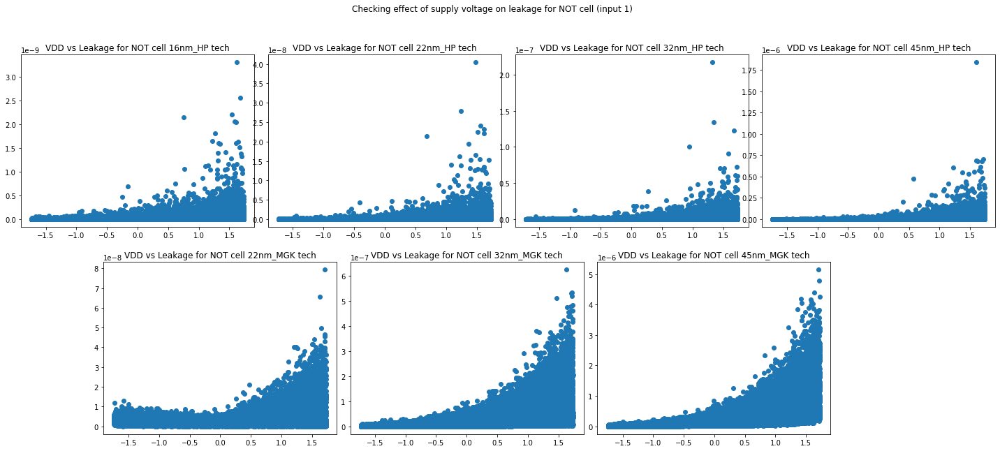

In [22]:
fig = plt.figure(figsize=(25, 10))
gs = gridspec.GridSpec(2, 12)

col = np.where(NOT_l_columns == "pvdd")

for i in range(7):
    if i < 4:
        ax = plt.subplot(gs[0, 3*i : 3*i+3])
    else:
        ax = plt.subplot(gs[1, 3*i-11 : 3*i+3-11])
    
    ax.scatter(x=x_NOT_l[i][1::2, col], y=y_NOT_l[i][1::2])
    ax.set_title(f"VDD vs Leakage for NOT cell {techs[i]} tech")

fig.suptitle("Checking effect of supply voltage on leakage for NOT cell (input 1)")

Text(0.5, 0.98, 'Checking effect of lmin on leakage for NOT cell (input 0)')

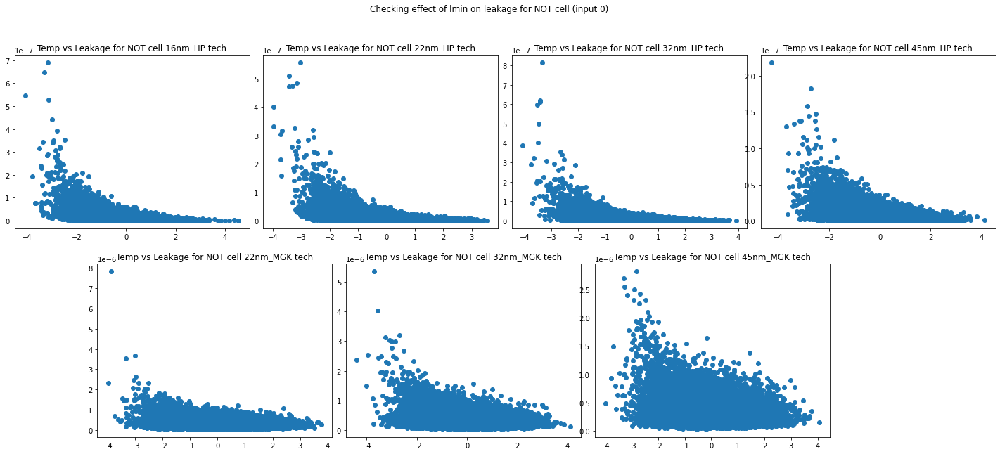

In [23]:
fig = plt.figure(figsize=(25, 10))
gs = gridspec.GridSpec(2, 12)

col = np.where(NOT_l_columns == "lmin")

for i in range(7):
    if i < 4:
        ax = plt.subplot(gs[0, 3*i : 3*i+3])
    else:
        ax = plt.subplot(gs[1, 3*i-11 : 3*i+3-11])
    
    x_data = x_NOT_l[i]
    y_data = y_NOT_l[i]
    ax.scatter(x=x_data[::2, col], y=y_data[::2])
    ax.set_title(f"Temp vs Leakage for NOT cell {techs[i]} tech")

fig.suptitle("Checking effect of lmin on leakage for NOT cell (input 0)")

Text(0.5, 0.98, 'Checking effect of lmin on leakage for NOT cell (input 1)')

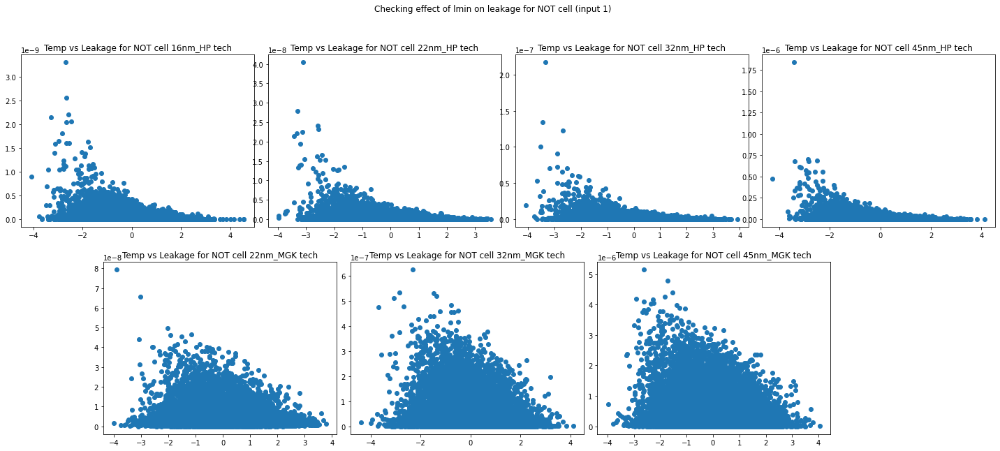

In [24]:
fig = plt.figure(figsize=(25, 10))
gs = gridspec.GridSpec(2, 12)

col = np.where(NOT_l_columns == "lmin")

for i in range(7):
    if i < 4:
        ax = plt.subplot(gs[0, 3*i : 3*i+3])
    else:
        ax = plt.subplot(gs[1, 3*i-11 : 3*i+3-11])
    
    x_data = x_NOT_l[i]
    y_data = y_NOT_l[i]
    ax.scatter(x=x_data[1::2, col], y=y_data[1::2])
    ax.set_title(f"Temp vs Leakage for NOT cell {techs[i]} tech")

fig.suptitle("Checking effect of lmin on leakage for NOT cell (input 1)")

## Scatter plots for delay

In [25]:
NOT_d_columns = NOT_16HP_d.columns

Text(0.5, 0.98, 'Scatter plots for delay in NOT cell (input 0) with 16nm_HP tech')

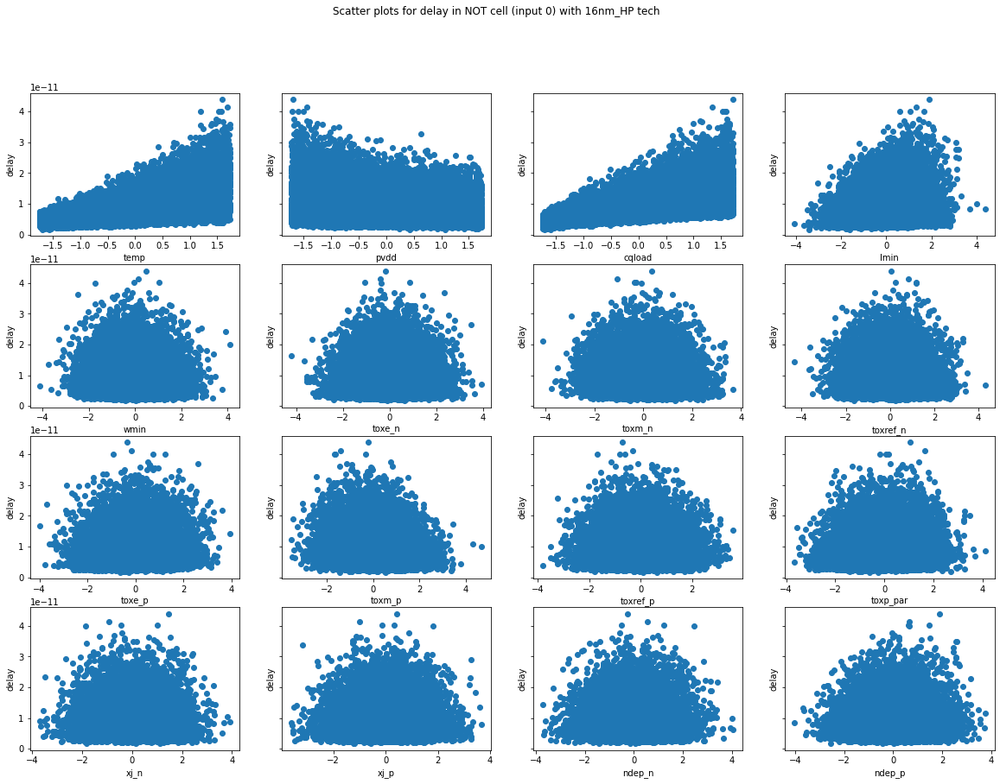

In [26]:
fig, ax = plt.subplots(4, 4, figsize=(20, 14), sharey=True)

for i in range(4):
    for j in range(4):
        k = 4*i + j
        ax[i,j].scatter(x=x_NOT_16HP_d[::2, k], y=y_NOT_16HP_d[::2])
        ax[i,j].set_xlabel(NOT_d_columns[k])
        ax[i,j].set_ylabel("delay")

fig.suptitle("Scatter plots for delay in NOT cell (input 0) with 16nm_HP tech")

Text(0.5, 0.98, 'Scatter plots for delay in NOT cell (input 1) with 16nm_HP tech')

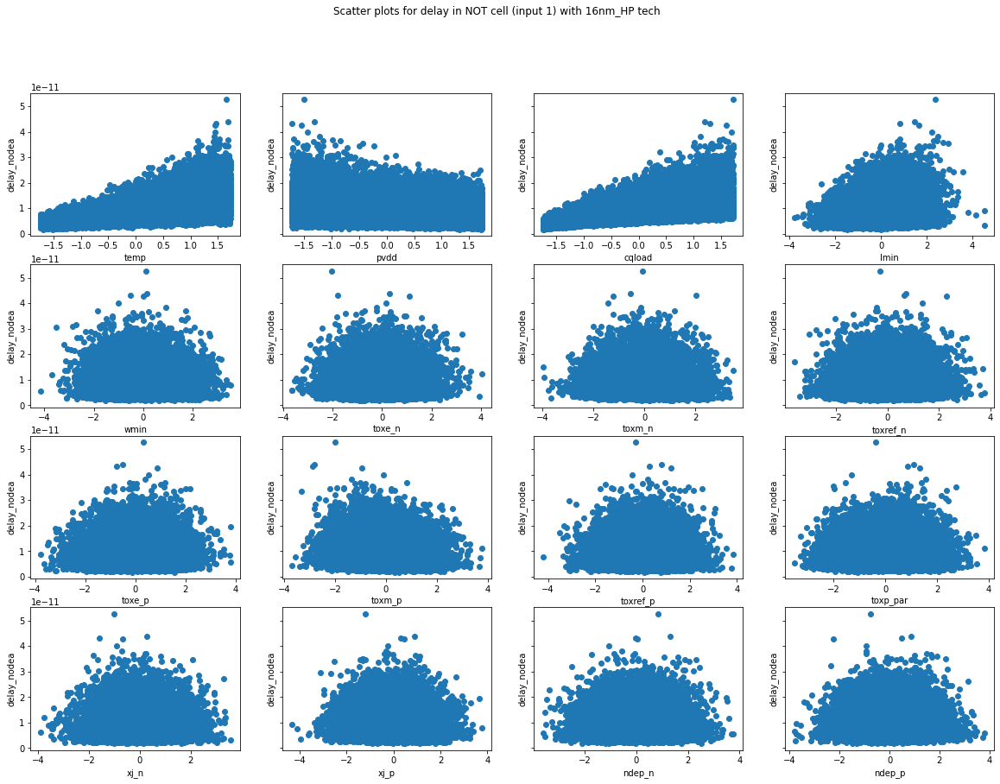

In [27]:
fig, ax = plt.subplots(4, 4, figsize=(20, 14), sharey=True)

for i in range(4):
    for j in range(4):
        k = 4*i + j
        ax[i,j].scatter(x=x_NOT_16HP_d[1::2, k], y=y_NOT_16HP_d[1::2])
        ax[i,j].set_xlabel(NOT_d_columns[k])
        ax[i,j].set_ylabel("delay_nodea")

fig.suptitle("Scatter plots for delay in NOT cell (input 1) with 16nm_HP tech")

Text(0.5, 0.98, 'Checking effect of supply voltage on delay for NOT cell (input 0)')

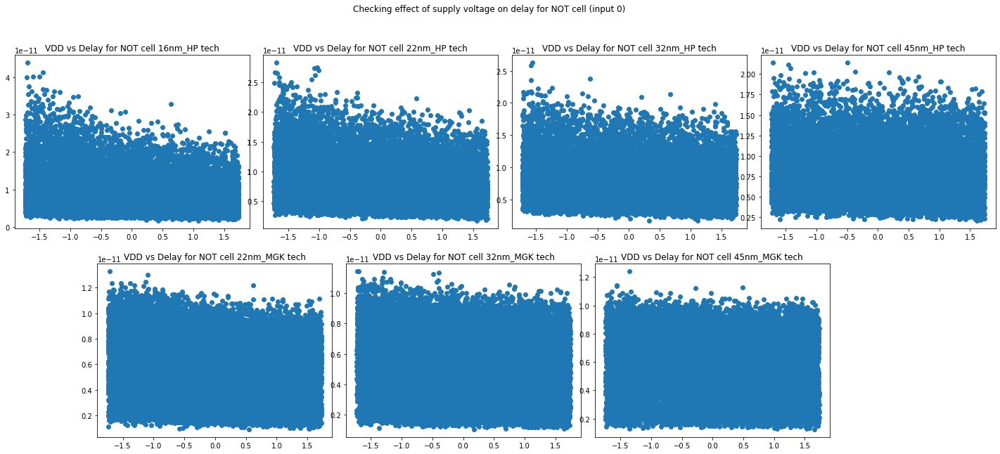

In [28]:
fig = plt.figure(figsize=(25, 10))
gs = gridspec.GridSpec(2, 12)

col = np.where(NOT_d_columns == "pvdd")

for i in range(7):
    if i < 4:
        ax = plt.subplot(gs[0, 3*i : 3*i+3])
    else:
        ax = plt.subplot(gs[1, 3*i-11 : 3*i+3-11])
    
    x_data = x_NOT_d[i]
    y_data = y_NOT_d[i]
    ax.scatter(x=x_data[::2, col], y=y_data[::2])
    ax.set_title(f"VDD vs Delay for NOT cell {techs[i]} tech")

fig.suptitle("Checking effect of supply voltage on delay for NOT cell (input 0)")

Text(0.5, 0.98, 'Checking effect of supply voltage on delay for NOT cell (input 1)')

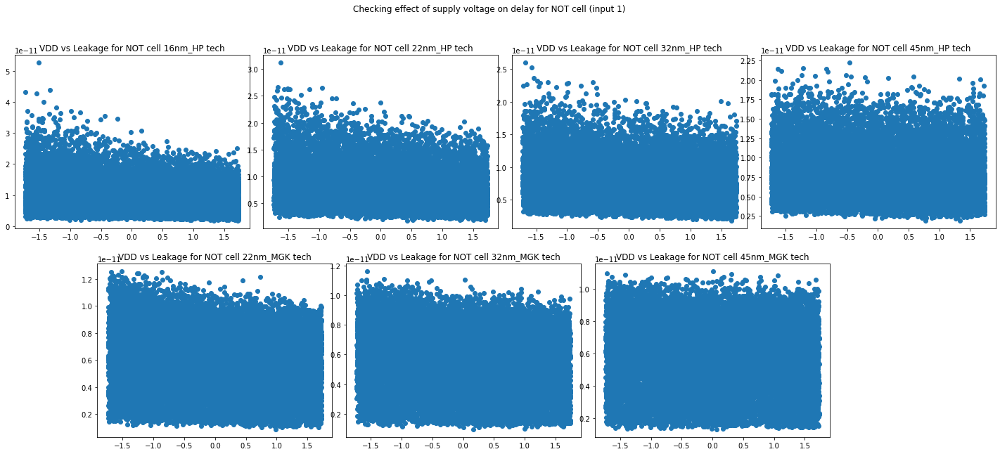

In [29]:
fig = plt.figure(figsize=(25, 10))
gs = gridspec.GridSpec(2, 12)

col = np.where(NOT_d_columns == "pvdd")

for i in range(7):
    if i < 4:
        ax = plt.subplot(gs[0, 3*i : 3*i+3])
    else:
        ax = plt.subplot(gs[1, 3*i-11 : 3*i+3-11])
    
    x_data = x_NOT_d[i]
    y_data = y_NOT_d[i]
    ax.scatter(x=x_data[1::2, col], y=y_data[1::2])
    ax.set_title(f"VDD vs Leakage for NOT cell {techs[i]} tech")

fig.suptitle("Checking effect of supply voltage on delay for NOT cell (input 1)")

Text(0.5, 0.98, 'Checking effect of load capacitance on delay for NOT cell (input 0)')

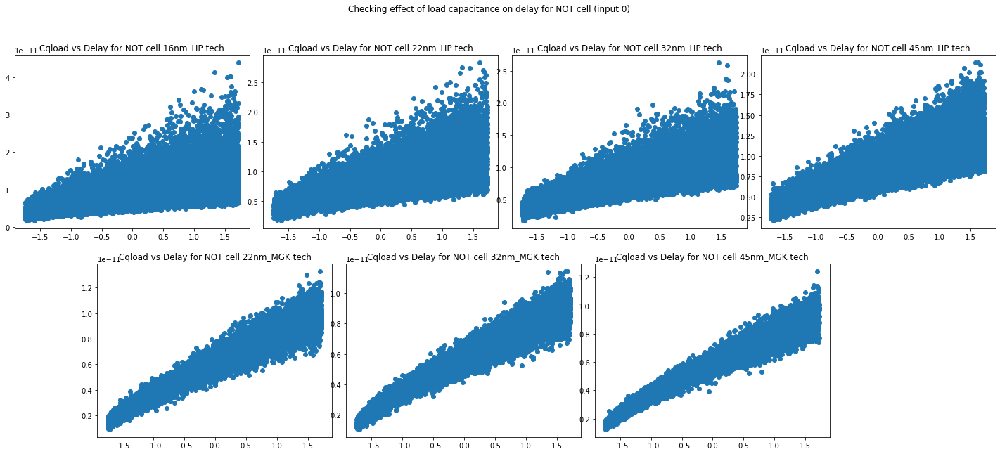

In [30]:
fig = plt.figure(figsize=(25, 10))
gs = gridspec.GridSpec(2, 12)

col = np.where(NOT_d_columns == "cqload")

for i in range(7):
    if i < 4:
        ax = plt.subplot(gs[0, 3*i : 3*i+3])
    else:
        ax = plt.subplot(gs[1, 3*i-11 : 3*i+3-11])
    
    x_data = x_NOT_d[i]
    y_data = y_NOT_d[i]
    ax.scatter(x=x_data[::2, col], y=y_data[::2])
    ax.set_title(f"Cqload vs Delay for NOT cell {techs[i]} tech")

fig.suptitle("Checking effect of load capacitance on delay for NOT cell (input 0)")

Text(0.5, 0.98, 'Checking effect of load capacitance on delay for NOT cell (input 1)')

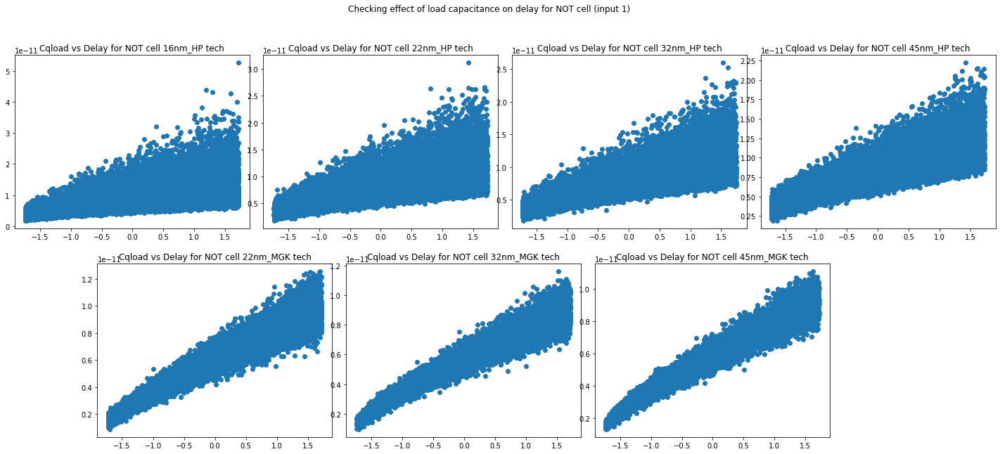

In [31]:
fig = plt.figure(figsize=(25, 10))
gs = gridspec.GridSpec(2, 12)

col = np.where(NOT_d_columns == "cqload")

for i in range(7):
    if i < 4:
        ax = plt.subplot(gs[0, 3*i : 3*i+3])
    else:
        ax = plt.subplot(gs[1, 3*i-11 : 3*i+3-11])
    
    x_data = x_NOT_d[i]
    y_data = y_NOT_d[i]
    ax.scatter(x=x_data[1::2, col], y=y_data[1::2])
    ax.set_title(f"Cqload vs Delay for NOT cell {techs[i]} tech")

fig.suptitle("Checking effect of load capacitance on delay for NOT cell (input 1)")

## PCA

In [32]:
def PCA_comp(x_data, ncomp):
    pca = PCA(n_components=ncomp)
    X_pca = pca.fit_transform(x_data)

    return X_pca

In [33]:
NOT_16HP_l_PCA = PCA_comp(x_NOT_16HP_l, 3)

fig = px.scatter_3d(x=NOT_16HP_l_PCA[:, 0], y=NOT_16HP_l_PCA[:, 1], z=NOT_16HP_l_PCA[:, 2], color=y_NOT_16HP_l)
fig.update_layout(
    title="PCA on leakage of NOT cell for 16nm HP",
    scene=dict(
    xaxis_title="First PC",
    yaxis_title="Second PC",
    zaxis_title="Third PC",
),)
fig.show()

In [34]:
NOT_45HP_l_PCA = PCA_comp(x_NOT_45HP_l, 3)

fig = px.scatter_3d(x=NOT_45HP_l_PCA[:, 0], y=NOT_45HP_l_PCA[:, 1], z=NOT_45HP_l_PCA[:, 2], color=y_NOT_45HP_l)
fig.update_layout(
    title="PCA on leakage of NOT cell for 45nm HP",
    scene=dict(
    xaxis_title="First PC",
    yaxis_title="Second PC",
    zaxis_title="Third PC",
),)
fig.show()

In [35]:
NOT_45MGK_l_PCA = PCA_comp(x_NOT_45MGK_l, 3)

fig = px.scatter_3d(x=NOT_45MGK_l_PCA[:, 0], y=NOT_45MGK_l_PCA[:, 1], z=NOT_45MGK_l_PCA[:, 2], color=y_NOT_45MGK_l)
fig.update_layout(
    title="PCA on leakage of NOT cell for 45nm MGK",
    scene=dict(
    xaxis_title="First PC",
    yaxis_title="Second PC",
    zaxis_title="Third PC",
),)
fig.show()

In [36]:
NOT_16HP_d_PCA = PCA_comp(x_NOT_16HP_d, 3)

fig = px.scatter_3d(x=NOT_16HP_d_PCA[:, 0], y=NOT_16HP_d_PCA[:, 1], z=NOT_16HP_d_PCA[:, 2], color=y_NOT_16HP_d)
fig.update_layout(
    title="PCA on delay of NOT cell for 16nm HP",
    scene=dict(
    xaxis_title="First PC",
    yaxis_title="Second PC",
    zaxis_title="Third PC",
),)
fig.show()

In [37]:
NOT_45HP_l_PCA = PCA_comp(x_NOT_45HP_l, 3)

fig = px.scatter_3d(x=NOT_45HP_l_PCA[:, 0], y=NOT_45HP_l_PCA[:, 1], z=NOT_45HP_l_PCA[:, 2], color=y_NOT_45HP_l)
fig.update_layout(
    title="PCA on leakage of NOT cell for 45nm HP",
    scene=dict(
    xaxis_title="First PC",
    yaxis_title="Second PC",
    zaxis_title="Third PC",
),)
fig.show()

In [38]:
NOT_45MGK_l_PCA = PCA_comp(x_NOT_45MGK_l, 3)

fig = px.scatter_3d(x=NOT_45MGK_l_PCA[:, 0], y=NOT_45MGK_l_PCA[:, 1], z=NOT_45MGK_l_PCA[:, 2], color=y_NOT_45MGK_l)
fig.update_layout(
    title="PCA on leakage of NOT cell for 45nm MGK",
    scene=dict(
    xaxis_title="First PC",
    yaxis_title="Second PC",
    zaxis_title="Third PC",
),)
fig.show()

## Box Plots

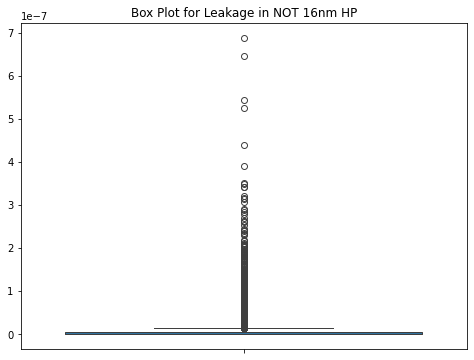

In [39]:
plt.figure(figsize=(8, 6))
sns.boxplot(data=y_NOT_16HP_l)
plt.title('Box Plot for Leakage in NOT 16nm HP')
plt.show()


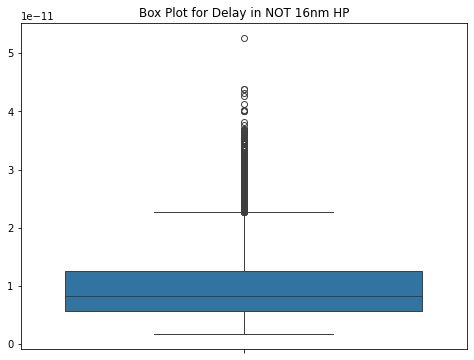

In [40]:
plt.figure(figsize=(8, 6))
sns.boxplot(data=y_NOT_16HP_d)
plt.title('Box Plot for Delay in NOT 16nm HP')
plt.show()

## Outliers 

In [41]:
# Identify outliers using Interquartile Range (IQR) method
q1 = np.quantile(y_NOT_16HP_l, 0.25)
q3 = np.quantile(y_NOT_16HP_l, 0.75)
iqr = q3 - q1
lower_bound = q1 - 1.5 * iqr
upper_bound = q3 + 1.5 * iqr
outliers = np.where((y_NOT_16HP_l < lower_bound) | (y_NOT_16HP_l > upper_bound))
print(f"Outliers using Interquartile Range (IQR) method:")
print(outliers[0].shape)

Outliers using Interquartile Range (IQR) method:
(6970,)


In [42]:
# Identify outliers using Z-score method
mean = y_NOT_16HP_l.mean()
std = y_NOT_16HP_l.std()
z_scores = abs((y_NOT_16HP_l - mean) / std)
outliers = np.where(z_scores > 3)
print(f"Outliers for using Z-score:")
print(outliers[0].shape)

Outliers for using Z-score:
(941,)


In [43]:
# Identify outliers using Interquartile Range (IQR) method
q1 = np.quantile(y_NOT_16HP_d, 0.25)
q3 = np.quantile(y_NOT_16HP_d, 0.75)
iqr = q3 - q1
lower_bound = q1 - 1.5 * iqr
upper_bound = q3 + 1.5 * iqr
outliers_iqr = np.where((y_NOT_16HP_d < lower_bound) | (y_NOT_16HP_d > upper_bound))
print(f"Outliers (IQR method):")
print(outliers_iqr[0].shape)

Outliers (IQR method):
(842,)
